In [43]:
import os
import igor
from igor.binarywave import Waves
import itertools

import bokeh
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models.mappers import LinearColorMapper
from bokeh.models import Range1d
import numpy as np
import pandas as pd

fontsize = "14pt"
output_notebook()

BokehJS successfully loaded.

In [4]:
cd /Users/nik/"Google Drive"/InXX_bottom_gates_Dec2015

/Users/nik/Google Drive/InXX_bottom_gates_Dec2015


### Room Temperature Data (300K)

In [28]:
# checking wire NBI591 #2 
# resistance as-fabricated, 

# sweeps go down-up-down

x = np.array([])
y = np.array([])
for i in range(1,3+1):
    w = Waves('dat{0:d}g1x.ibw'.format(i), y_multiplier = 1e-7/10e-6/3.75e-5)
    x = np.append(x,w.x)
    y = np.append(y,w.y)
    
p = figure(plot_width=600, plot_height=400, title_text_font_size = fontsize)
p.xaxis.axis_label_text_font_size = fontsize
p.yaxis.axis_label_text_font_size = fontsize

p.scatter(x,y)

p.title = 'NBI591 #2'
p.xaxis.axis_label="V_center (mV)"
p.yaxis.axis_label="G (e^2/h)"

show(p)
# resistance at V_center = 0V, 260kOhm

In [29]:
# checking wire NBI591 #3

x = np.array([])
y = np.array([])
for i in range(4,6+1):
    w = Waves('dat{0:d}g1x.ibw'.format(i), y_multiplier = 1e-7/10e-6/3.75e-5)
    x = np.append(x,w.x)
    y = np.append(y,w.y)

p = figure(plot_width=600, plot_height=400, title_text_font_size = fontsize)
p.xaxis.axis_label_text_font_size = fontsize
p.yaxis.axis_label_text_font_size = fontsize

p.scatter(x,y)

p.title = 'NBI591 #3'
p.xaxis.axis_label="V_center (mV)"
p.yaxis.axis_label="G (e^2/h)"

show(p)

# resistance at V_center = 0V, 435kOhm

In [50]:
# checking wire NBI591 #1

# DEAD!

In [51]:
# checking wire QDEV173

# DEAD!

In [32]:
# checking wire QDEV187
# resistance as-fabricated, 9.6kOhm

x = np.array([])
y = np.array([])
for i in range(7,9+1):
    w = Waves('dat{0:d}g1x.ibw'.format(i), y_multiplier = 1e-7/10e-6/3.75e-5)
    x = np.append(x,w.x)
    y = np.append(y,w.y)
    
p = figure(plot_width=600, plot_height=400, 
           title_text_font_size = fontsize)
p.xaxis.axis_label_text_font_size = fontsize
p.yaxis.axis_label_text_font_size = fontsize

p.scatter(x,y)

p.title = 'QDEV187'
p.xaxis.axis_label="V_center (mV)"
p.yaxis.axis_label="G (e^2/h)"

show(p)

# resistance at V_center = 0V, 12.5kOhm

### Low Temperature Data (16.5mK)

Only device QDEV187 was still alive at base temperature. The InAs and InAs+Al wires showed zero conductance at base temperature.

No data was taken as the device was cooled from room temperature to base temperature. Our hacked together cold finger seems to sit at about 16.5mK (1.5ueV). 

The AC bias for all of the data below is 10uV, which is likely heating the sample slightly above the base temperature.

In [48]:
import matplotlib.pyplot as plt
def rgb_to_hex(rgb):
    return '#%02x%02x%02x' % rgb[0:3]

def return_bokeh_colormap(name):
    cm = plt.cm.get_cmap(name)
    colormap = [rgb_to_hex(tuple((np.array(cm(x))*255).astype(np.int))) for x in range(0,cm.N)]
    return colormap

In [49]:
w = Waves('dat29g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)

bwr = return_bokeh_colormap('seismic')

p = figure(plot_width=600, plot_height=400, 
           title_text_font_size = fontsize,
           title = 'T=16.5, V1=V5=0V, dat29g2d1x.ibw')
p.xaxis.axis_label_text_font_size = fontsize
p.yaxis.axis_label_text_font_size = fontsize

x0 = w.extent[0]
y0 = w.extent[2]
dw = w.extent[1]-w.extent[0]
dh = w.extent[3]-w.extent[2]
p.image(image=[w.y], x=[x0], y=[y0], dw=[dw], dh=[dh], color_mapper=LinearColorMapper(bwr))
p.set(x_range=Range1d(w.extent[0], w.extent[1]), y_range=Range1d(w.extent[2], w.extent[3]))

# p.xaxis.axis_label="V_center (mV)"
# p.yaxis.axis_label="G (e^2/h)"

show(p)

<IPython.core.display.Javascript object>


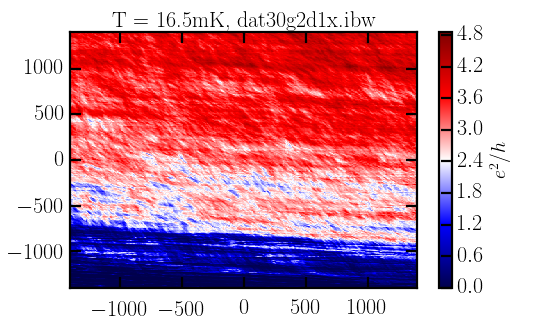

In [54]:
w = Waves('dat30g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', 
               extent=w.extent, cmap = plt.cm.seismic, aspect = 'auto', interpolation='nearest')
# ax.set_ylim(-600, -200)
ax.set_xlabel('$V_2 = V_{3} = V_4$ (mV)')
ax.set_ylabel('$V_1 = V_5$ (mV)')
ax.set_title('T = 16.5mK, dat30g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


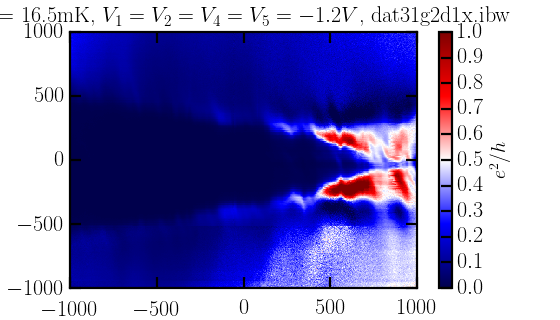

In [55]:
w = Waves('dat31g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower',
               extent=w.extent, cmap = plt.cm.seismic, vmin=0.0, vmax = 1.0, 
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{3}\ (mV)$')
ax.set_ylabel('$V_{bias}\ (\mu V)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_4=V_5=-1.2V$, dat31g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

# I should have swept the bias fast and the gate slow, this is a strange way to do things

<IPython.core.display.Javascript object>


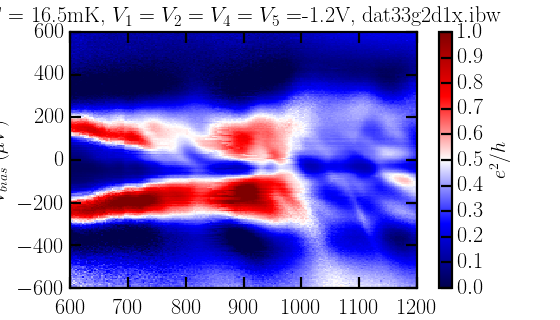

In [56]:
# a closer look at a portion of 

w = Waves('dat33g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower',
               extent=w.extent, cmap = plt.cm.seismic, vmin=0.0, vmax=1.0,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{3}\ (mV)$')
ax.set_ylabel('$V_{bias}\ (\mu V)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_4=V_5=$-1.2V, dat33g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


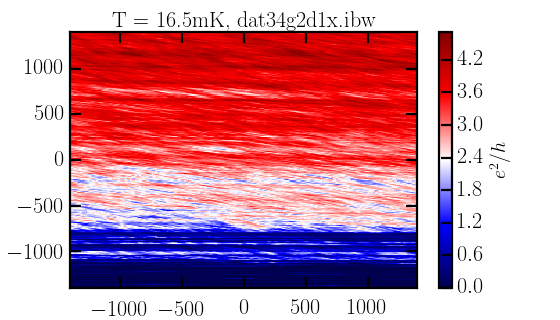

In [57]:
w = Waves('dat34g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower',
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{3}\ (mV)$')
ax.set_ylabel('$V_1=V_2=V_4=V_5\ (mV)$')
ax.set_title('T = 16.5mK, dat34g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


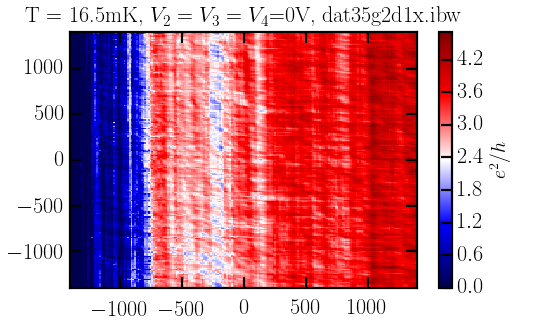

In [58]:
w = Waves('dat35g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower',
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_5\ (mV)$')
ax.set_ylabel('$V_1\ (mV)$')
ax.set_title('T = 16.5mK, $V_2=V_3=V_4$=0V, dat35g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


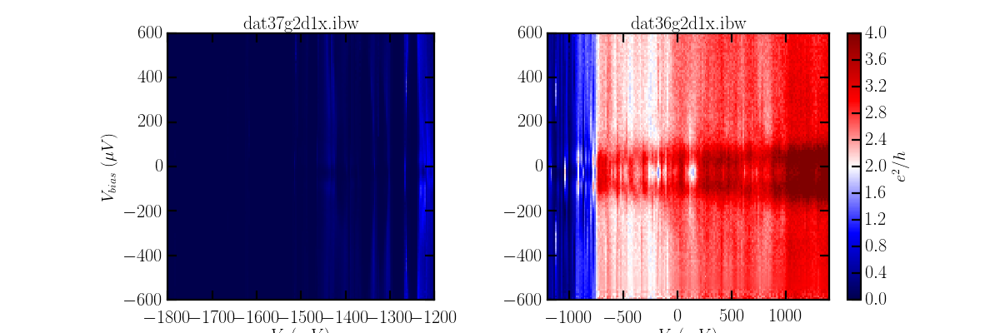

In [59]:
# 'T = 16.5mK, $V_1=V_2=V_3=V_4=0$

w = Waves('dat36g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = False)
u = Waves('dat37g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = False)

fig, ax = plt.subplots(1,2, figsize = (15,5))
im = ax[0].imshow(u.y, origin='lower', vmin = 0.0, vmax = 4.0,
               extent=u.extent, cmap = plt.cm.seismic,
               interpolation='nearest', aspect='0.5')
ax[0].set_xlabel('$V_5\ (mV)$')
ax[0].set_ylabel('$V_{bias}\ (\mu V)$')
ax[0].set_title('dat37g2d1x.ibw')

im = ax[1].imshow(w.y[:,14:], origin='lower', vmin = 0.0, vmax = 4.0,
               extent=[-1200, 1400, -600,600], cmap = plt.cm.seismic,
               interpolation='nearest', aspect='auto')
ax[1].set_xlabel('$V_5\ (mV)$')
#ax[1].set_ylabel('$V_{bias}\ (\mu V)$')
ax[1].set_title('dat36g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

In [60]:
# def find_nearest(array, value):
#     idx = (np.abs(array-value)).argmin()
#     return idx

# w = Waves('dat36g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = False)
# fig, ax = plt.subplots(1,1)

# N=11
# palette = itertools.cycle(plt.cm.coolwarm(np.linspace(0, 1, N)))
# x = np.linspace(-600,600,121)
# y = np.linspace(-1400,1400,201)
# gates = np.linspace(-1000.0, 200.0, N)
# for g in gates:
#     color = next(palette)
#     ax.plot(x, w.y[:,find_nearest(y,g)], color = color, label = '{0} mV'.format(g))
# # ax.legend(loc='upper left')
# ax.set_xlim(-300, 300)
# ax.set_ylim(0.0, 3.5)

# ax.set_xlabel('$V_{bias}\ (\mu V)$')
# ax.set_ylabel('$G\ (e^2/h)$')
# ax.set_title('T = 16.5mK, $V_1=V_2=V_3=V_4=0$, dat36g2d1x.ibw')

<IPython.core.display.Javascript object>


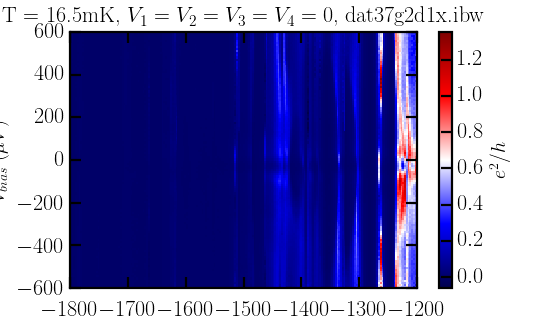

In [61]:
w = Waves('dat37g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = False)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', #vmin = 0.0, vmax = 5.0,
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_5\ (mV)$')
ax.set_ylabel('$V_{bias}\ (\mu V)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_3=V_4=0$, dat37g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


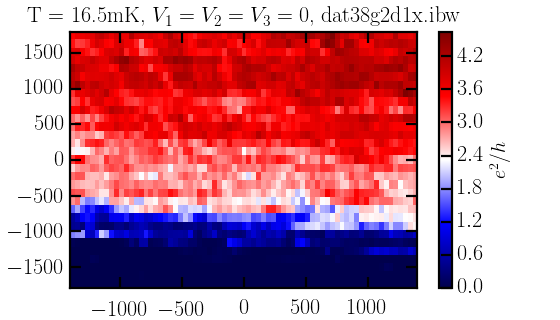

In [62]:
w = Waves('dat38g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', #vmin = 0.0, vmax = 5.0,
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{4}\ (mV)$')
ax.set_ylabel('$V_{5}\ (mV)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_3=0$, dat38g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


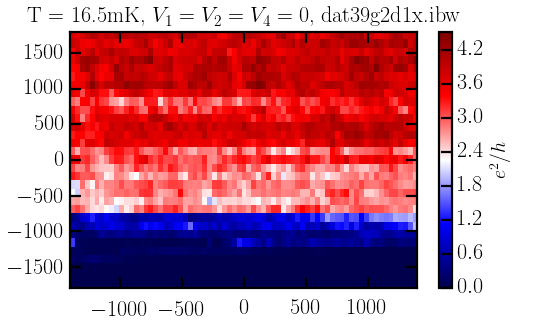

In [63]:
w = Waves('dat39g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', #vmin = 0.0, vmax = 5.0,
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{3}\ (mV)$')
ax.set_ylabel('$V_{5}\ (mV)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_4=0$, dat39g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


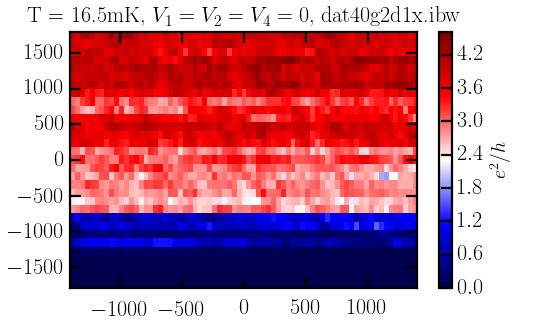

In [64]:
w = Waves('dat40g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', #vmin = 0.0, vmax = 5.0,
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{2}\ (mV)$')
ax.set_ylabel('$V_{5}\ (mV)$')
ax.set_title('T = 16.5mK, $V_1=V_2=V_4=0$, dat40g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

<IPython.core.display.Javascript object>


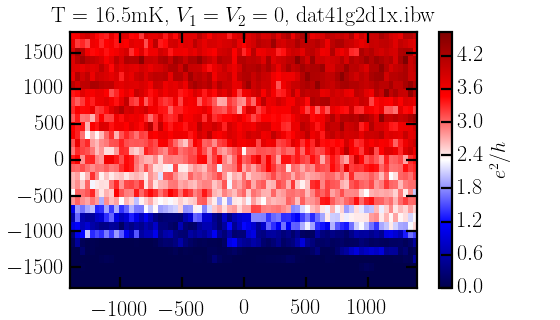

In [65]:
w = Waves('dat41g2d1x.ibw', y_multiplier = 1e-7/10e-6/3.75e-5, transpose = True)
fig, ax = plt.subplots(1,1)
im = ax.imshow(w.y, origin='lower', #vmin = 0.0, vmax = 5.0,
               extent=w.extent, cmap = plt.cm.seismic,
               aspect = 'auto', interpolation='nearest')
ax.set_xlabel('$V_{3}=V_{4}\ (mV)$')
ax.set_ylabel('$V_{5}\ (mV)$')
ax.set_title('T = 16.5mK, $V_1=V_2=0$, dat41g2d1x.ibw')

cb = plt.colorbar(im)
cb.set_label(r'$e^2/h$')

Given that only gate 5 works, this seems to be all of the data that is needed from this sample. Pulling it now.